In [1]:
!date

vie ene 10 10:48:56 CET 2020


In [2]:
# Active system's automagic
%automagic on


Automagic is ON, % prefix IS NOT needed for line magics.


In [3]:
# Load work environment

In [4]:
import os
os.getcwd()

'/home/dsc/Repos/TFM_Categorize_providers_based_on_descriptions_of_the_drug_plans/02_Development'

In [5]:
#folder = '/home/dsc/Repos/TFM_Categorize_providers_based_on_descriptions_of_the_drug_plans/03_Presentation'
folder = os.getcwd()
!ls {folder}

01_loading_and_preprocessing_original_data_complete.ipynb
01_Loading_and_preprocessing_original_data.ipynb
02_Draw_transformed_data.ipynb
03_Data_preparation_and_pipelines_of_naive_models.ipynb
04a_roc_auc_LOGREG_sag_hyperparameters.ipynb
04b_roc_auc_LOGREG_saga_hyperparameters.ipynb
04_Data_model_improvement_hyperparameters.ipynb
05_roc_auc_SVC.ipynb
Untitled.ipynb


In [6]:
os.chdir(folder)
os.getcwd()

'/home/dsc/Repos/TFM_Categorize_providers_based_on_descriptions_of_the_drug_plans/02_Development'

In [7]:
# Load library for work and analitics data
import pandas as pd
import numpy as np

In [8]:
!ls -ltr ../03_Presentation/02_OUT_csv_original_data_transformed.csv

-rw-rw-r-- 1 dsc dsc 27565813 ene  7 11:12 ../03_Presentation/02_OUT_csv_original_data_transformed.csv


In [9]:
# Read from excel files complete with column names stipulated and transform them
# (1) Imports:
import os
import glob

In [10]:
# (2) File list:
path = os.chdir(os.getcwd() + '/..' + '/03_Presentation')
!pwd

/home/dsc/Repos/TFM_Categorize_providers_based_on_descriptions_of_the_drug_plans/03_Presentation


In [11]:
%%time
# (3) Upload cvsv file:
df_from_xlsx_total = pd.read_csv("02_OUT_csv_original_data_transformed.csv")

CPU times: user 680 ms, sys: 43.4 ms, total: 723 ms
Wall time: 758 ms


In [12]:
len(df_from_xlsx_total)

306183

In [13]:
df_from_xlsx_total.columns

Index(['ESTADO', 'CONDADO', 'ORGANIZACION', 'TIPO_PLAN_GENERICO_MEDICARE',
       'PRIMA_MENSUAL_CONSOLIDADA', 'MEDICAMS_ANUALES_DEDUCIBLES',
       'TIPO_BENEFICIO', 'COBERTURA_ADICIONAL_OFRECIDA', 'DETALLE_BENEFICIO',
       'DESEMBOLSO_MAXIMO', 'CLASIFICACION'],
      dtype='object')

In [14]:
# Data mapping

In [15]:
df_ratings_lab_ohe = df_from_xlsx_total.reset_index(drop=True).copy()

In [16]:
df_ratings_lab_ohe.head(1)

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,Alabama,Autauga,UnitedHealthcare,HMO,0.0,0.0,Enhanced,No Gap Coverage,EA,4450.0,2.5


In [17]:
df_ratings_lab_ohe.columns

Index(['ESTADO', 'CONDADO', 'ORGANIZACION', 'TIPO_PLAN_GENERICO_MEDICARE',
       'PRIMA_MENSUAL_CONSOLIDADA', 'MEDICAMS_ANUALES_DEDUCIBLES',
       'TIPO_BENEFICIO', 'COBERTURA_ADICIONAL_OFRECIDA', 'DETALLE_BENEFICIO',
       'DESEMBOLSO_MAXIMO', 'CLASIFICACION'],
      dtype='object')

In [18]:
df_ratings_lab_ohe.dtypes

ESTADO                           object
CONDADO                          object
ORGANIZACION                     object
TIPO_PLAN_GENERICO_MEDICARE      object
PRIMA_MENSUAL_CONSOLIDADA       float64
MEDICAMS_ANUALES_DEDUCIBLES     float64
TIPO_BENEFICIO                   object
COBERTURA_ADICIONAL_OFRECIDA     object
DETALLE_BENEFICIO                object
DESEMBOLSO_MAXIMO               float64
CLASIFICACION                    object
dtype: object

In [19]:
# Dont limit column display
import pandas as pd
from IPython.display import display

pd.options.display.max_columns = None
display(df_ratings_lab_ohe.head(1))

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,Alabama,Autauga,UnitedHealthcare,HMO,0.0,0.0,Enhanced,No Gap Coverage,EA,4450.0,2.5


In [20]:
# Check NULL values
df_ratings_lab_ohe.isnull().sum()

ESTADO                          0
CONDADO                         0
ORGANIZACION                    0
TIPO_PLAN_GENERICO_MEDICARE     0
PRIMA_MENSUAL_CONSOLIDADA       0
MEDICAMS_ANUALES_DEDUCIBLES     0
TIPO_BENEFICIO                  0
COBERTURA_ADICIONAL_OFRECIDA    0
DETALLE_BENEFICIO               0
DESEMBOLSO_MAXIMO               0
CLASIFICACION                   0
dtype: int64

In [21]:
# Check NaN values
df_ratings_lab_ohe.isna().sum()

ESTADO                          0
CONDADO                         0
ORGANIZACION                    0
TIPO_PLAN_GENERICO_MEDICARE     0
PRIMA_MENSUAL_CONSOLIDADA       0
MEDICAMS_ANUALES_DEDUCIBLES     0
TIPO_BENEFICIO                  0
COBERTURA_ADICIONAL_OFRECIDA    0
DETALLE_BENEFICIO               0
DESEMBOLSO_MAXIMO               0
CLASIFICACION                   0
dtype: int64

In [22]:
print(pd.options.display.max_columns)

None


In [23]:
print(pd.options.display.max_rows)

60


In [24]:
df_ratings_lab_ohe["ESTADO"] = df_ratings_lab_ohe["ESTADO"].astype(np.str)
df_ratings_lab_ohe["CONDADO"] = df_ratings_lab_ohe["CONDADO"].astype(np.str)
df_ratings_lab_ohe["ORGANIZACION"] = df_ratings_lab_ohe["ORGANIZACION"].astype(np.str)
df_ratings_lab_ohe["TIPO_PLAN_GENERICO_MEDICARE"] = df_ratings_lab_ohe["TIPO_PLAN_GENERICO_MEDICARE"].astype(np.str)
df_ratings_lab_ohe["PRIMA_MENSUAL_CONSOLIDADA"] = df_ratings_lab_ohe["PRIMA_MENSUAL_CONSOLIDADA"].astype(np.float64)
df_ratings_lab_ohe["MEDICAMS_ANUALES_DEDUCIBLES"] = df_ratings_lab_ohe["MEDICAMS_ANUALES_DEDUCIBLES"].astype(np.float64)
df_ratings_lab_ohe["TIPO_BENEFICIO"] = df_ratings_lab_ohe["TIPO_BENEFICIO"].astype(np.str)
df_ratings_lab_ohe["COBERTURA_ADICIONAL_OFRECIDA"] = df_ratings_lab_ohe["COBERTURA_ADICIONAL_OFRECIDA"].astype(np.str)
df_ratings_lab_ohe["DETALLE_BENEFICIO"] = df_ratings_lab_ohe["DETALLE_BENEFICIO"].astype(np.str)
df_ratings_lab_ohe["DESEMBOLSO_MAXIMO"] = df_ratings_lab_ohe["DESEMBOLSO_MAXIMO"].astype(np.float64)
df_ratings_lab_ohe["CLASIFICACION"] = df_ratings_lab_ohe["CLASIFICACION"].astype(np.str)

# Data Preparation

In [25]:
# Labeling through Label Encoding
from sklearn.preprocessing import LabelEncoder
lab = LabelEncoder() 

In [26]:
df_ratings_lab_ohe['ESTADO']= lab.fit_transform(df_ratings_lab_ohe['ESTADO'])
df_ratings_lab_ohe['CONDADO']= lab.fit_transform(df_ratings_lab_ohe['CONDADO'])
df_ratings_lab_ohe['ORGANIZACION']= lab.fit_transform(df_ratings_lab_ohe['ORGANIZACION'])
#df_ratings_lab_ohe['PLAN']= lab.fit_transform(df_ratings_lab_ohe['PLAN'])
df_ratings_lab_ohe['TIPO_PLAN_GENERICO_MEDICARE']= lab.fit_transform(df_ratings_lab_ohe['TIPO_PLAN_GENERICO_MEDICARE'])
df_ratings_lab_ohe['PRIMA_MENSUAL_CONSOLIDADA']= lab.fit_transform(df_ratings_lab_ohe['PRIMA_MENSUAL_CONSOLIDADA'])
df_ratings_lab_ohe['MEDICAMS_ANUALES_DEDUCIBLES']= lab.fit_transform(df_ratings_lab_ohe['MEDICAMS_ANUALES_DEDUCIBLES'])
df_ratings_lab_ohe['TIPO_BENEFICIO']= lab.fit_transform(df_ratings_lab_ohe['TIPO_BENEFICIO'])
df_ratings_lab_ohe['COBERTURA_ADICIONAL_OFRECIDA']= lab.fit_transform(df_ratings_lab_ohe['COBERTURA_ADICIONAL_OFRECIDA'])
df_ratings_lab_ohe['DETALLE_BENEFICIO']= lab.fit_transform(df_ratings_lab_ohe['DETALLE_BENEFICIO'])
#df_ratings_lab_ohe['CONTRATO_ID']= lab.fit_transform(df_ratings_lab_ohe['CONTRATO_ID'])
#df_ratings_lab_ohe['PLAN_ID']= lab.fit_transform(df_ratings_lab_ohe['PLAN_ID'])
#df_ratings_lab_ohe['SEGMENTO_ID']= lab.fit_transform(df_ratings_lab_ohe['SEGMENTO_ID'])
df_ratings_lab_ohe['DESEMBOLSO_MAXIMO']= lab.fit_transform(df_ratings_lab_ohe['DESEMBOLSO_MAXIMO'])
#df_ratings_lab_ohe['CLASIFICACION']= lab.fit_transform(df_ratings_lab_ohe['CLASIFICACION'])

In [27]:
df_ratings_lab_ohe.head(1)

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,0,86,476,1,0,0,1,19,3,81,2.5


In [28]:
# Load variables with sample data.
X = np.array(df_ratings_lab_ohe.drop('CLASIFICACION', 1))
y = np.array(df_ratings_lab_ohe["CLASIFICACION"])
X.shape

(306183, 10)

In [26]:
# normalization
#X=(X-np.min(X))/(np.max(X)-np.min(X))

In [28]:
# Train-test split and load the library
from sklearn.model_selection import train_test_split
# Create 2 groups each with input and labels
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=0)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20)

In [29]:
# Feature Scaling (normalization)
from sklearn.preprocessing import StandardScaler 
sc = StandardScaler() 
X_train = sc.fit_transform(X_train) 
X_test = sc.transform(X_test)

In [30]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder

In [31]:
# Create the encoder (by OneHotEncoder)
encoder = OneHotEncoder(handle_unknown='ignore')
# Assume for simplicity all features are categorical.
encoder.fit(X_train)

OneHotEncoder(categorical_features=None, categories=None, drop=None,
              dtype=<class 'numpy.float64'>, handle_unknown='ignore',
              n_values=None, sparse=True)

In [32]:
# Apply the encoder.
X_train = encoder.transform(X_train)
X_test = encoder.transform(X_test)

In [33]:
X.shape

(306183, 10)

In [34]:
X_train

<244946x3794 sparse matrix of type '<class 'numpy.float64'>'
	with 2449460 stored elements in Compressed Sparse Row format>

In [35]:
X_test

<61237x3794 sparse matrix of type '<class 'numpy.float64'>'
	with 612340 stored elements in Compressed Sparse Row format>

In [36]:
#################

In [37]:
###############

In [38]:
# import warnings filter
from warnings import simplefilter
# ignore all future warnings
simplefilter(action='ignore', category=FutureWarning)

In [39]:
###################

## Logistic regression model with SKLearn

In [240]:
# Import the necessary modules
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model.sag import sag_solver
from sklearn.metrics import confusion_matrix, classification_report
# Create teh Regression Logistic model and we make it fit (ajuste) to our set of inputs X and outputs "y".
model_LOGREG = linear_model.LogisticRegression(multi_class='auto', solver='sag', verbose=0, max_iter=10000)
model_LOGREG.fit(X_train,y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=10000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='sag', tol=0.0001, verbose=0,
                   warm_start=False)

In [241]:
#Y confirmamos cuan bueno fue nuestro modelo utilizando model.score() que nos devuelve
#la precisión media de las predicciones, en nuestro caso del 59%
model_LOGREG.score(X_train, y_train)

0.829625

In [171]:
from sklearn import metrics

In [172]:
metrics.accuracy_score(y_train, model_LOGREG.predict(X_train))

0.74375

In [173]:
metrics.accuracy_score(y_test, model_LOGREG.predict(X_test))

0.615

In [242]:
# We classify our entire set of X inputs using the "predict (X)" method for the model
# and we review some of its outputs to see if it matches the actual outputs of our origin
predictions_LOGREG = model_LOGREG.predict(X_test)

In [ ]:
# Compute and print the confusion matrix and classification report
print(confusion_matrix(y_test, predictions_LOGREG))
print(classification_report(y_test, predictions_LOGREG))

In [243]:
# Check prediction classifier

In [244]:
print(predictions_LOGREG[77])

3.5


In [245]:
df_ratings_lab_ohe["CLASIFICACION"][77]

'4'

In [246]:
print(predictions_LOGREG[0:77])

['3.5' '3.5' '3' '3.5' '3.5' '4' '4' '3' '3' '3' '3.5' '3.5' '4' '3.5'
 '3.5' '3.5' '4' '3' '4' '2.5' '2.5' '3.5' '4.5' '3.5' '3.5' '4.5' '3.5'
 '3.5' '4.5' '3.5' '2.5' '4' '3.5' '4.5' '4.5' '4' '4.5' '3.5' '4' '4'
 '4.5' '4.5' '3.5' '5' 'NO_ASIGNADO' '4.5' '3' '4' '3' '3.5' '3.5' '4' '4'
 '4' '3.5' 'NO_ASIGNADO' '3' '3.5' '3' 'NO_ASIGNADO' '3.5' '3' '4.5' '3'
 '4.5' '4' '4.5' '3.5' '4' '3' '3.5' '4.5' '4' '3' '2.5' '3.5' '2.5']


In [248]:
type(predictions_LOGREG)

numpy.ndarray

In [249]:
predictions_LOGREG.dtype

dtype('O')

In [250]:
predictions_LOGREG.shape

(2000,)

In [251]:
# Check model efficiency 

In [252]:
print(accuracy_score(y_test, predictions_LOGREG))

0.6425


In [254]:
# The Quality of our model, gives us the average accuracy of the predictions
model_LOGREG.score(X_test,y_test)

0.6425

########################################################

##########################################

############################

## VALIDATE MODEL

In [274]:
df_ratings_lab_ohe.columns

Index(['ESTADO', 'CONDADO', 'ORGANIZACION', 'TIPO_PLAN_GENERICO_MEDICARE',
       'PRIMA_MENSUAL_CONSOLIDADA', 'MEDICAMS_ANUALES_DEDUCIBLES',
       'TIPO_BENEFICIO', 'COBERTURA_ADICIONAL_OFRECIDA', 'DETALLE_BENEFICIO',
       'DESEMBOLSO_MAXIMO', 'CLASIFICACION'],
      dtype='object')

In [275]:
df_ratings_lab_ohe.dtypes

ESTADO                           object
CONDADO                          object
ORGANIZACION                     object
TIPO_PLAN_GENERICO_MEDICARE      object
PRIMA_MENSUAL_CONSOLIDADA       float64
MEDICAMS_ANUALES_DEDUCIBLES     float64
TIPO_BENEFICIO                   object
COBERTURA_ADICIONAL_OFRECIDA     object
DETALLE_BENEFICIO                object
DESEMBOLSO_MAXIMO               float64
CLASIFICACION                    object
dtype: object

In [276]:
df_ratings_lab_ohe.head(1)

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,Alabama,Autauga,UnitedHealthcare,HMO,0.0,0.0,Enhanced,No Gap Coverage,EA,4450.0,2.5


In [277]:
# We recompile our Logistic Regression model, at 80% of the input data in 10 partitions 
# and we calculate the new scoring by cross validation
name='Logistic Regression'
kfold = model_selection.KFold(n_splits=10)
cv_results = model_selection.cross_val_score(model_LOGREG, X_train, y_train, cv=kfold, \
                                             scoring='accuracy', error_score=np.nan, verbose=0)
msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
print(msg)

Logistic Regression: 0.739559 (0.002204)


In [278]:
# And now we make the predictions (really classification) using our "cross validation set"
# that is to say of the subset that we had separated.
# Successes: xxx%
predictions_LOGREG = model_LOGREG.predict(X_test)
print(accuracy_score(y_test, predictions_LOGREG))

0.7412348743406764


# Model results

In [279]:
## Matrix of confusion for errors
print(confusion_matrix(y_test, predictions_LOGREG))

[[   97    16     7     4     0     0     0    16]
 [    0  3880   494    61    14     0     0    74]
 [    0   387  6311  1956   365    54     1   227]
 [    0    31  1150 11830  2015   325     2   154]
 [    0    12   492  2916 10018  1286    15   122]
 [    0     1    91   632  1497  8471   125    87]
 [    0     0     0    28    16   138  1308     3]
 [    2    67   441   183   216   118     5  3476]]


In [280]:
## Classification report with our TEST set
# We observe the average F1-score
print(classification_report(y_test, predictions_LOGREG))

              precision    recall  f1-score   support

           2       0.98      0.69      0.81       140
         2.5       0.88      0.86      0.87      4523
           3       0.70      0.68      0.69      9301
         3.5       0.67      0.76      0.71     15507
           4       0.71      0.67      0.69     14861
         4.5       0.82      0.78      0.80     10904
           5       0.90      0.88      0.89      1493
 NO_ASIGNADO       0.84      0.77      0.80      4508

    accuracy                           0.74     61237
   macro avg       0.81      0.76      0.78     61237
weighted avg       0.74      0.74      0.74     61237



In [ ]:
aqui

# Classification (or prediction) of new values

In [281]:
df_ratings_lab_ohe.columns

Index(['ESTADO', 'CONDADO', 'ORGANIZACION', 'TIPO_PLAN_GENERICO_MEDICARE',
       'PRIMA_MENSUAL_CONSOLIDADA', 'MEDICAMS_ANUALES_DEDUCIBLES',
       'TIPO_BENEFICIO', 'COBERTURA_ADICIONAL_OFRECIDA', 'DETALLE_BENEFICIO',
       'DESEMBOLSO_MAXIMO', 'CLASIFICACION'],
      dtype='object')

In [282]:
df_ratings_lab_ohe.head(1)

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,Alabama,Autauga,UnitedHealthcare,HMO,0.0,0.0,Enhanced,No Gap Coverage,EA,4450.0,2.5


In [283]:
df_ratings_lab_ohe_sample.head(1)

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,33,534,268,1,148,0,2,11,4,36,4


In [284]:
# Test and others parameters:
# a.- predict: just gives you the class for every example
# b.- predict_proba: gives you the probability for every class, and predict is just taking the class 
#     which maximal probability
# c.- predict_log_proba: gives you the logarithm of the probabilities, this is often handier as probabilities 
#     can become very, very small shareimprove this answer
# d.- coef_
# e.- score
# f.- decision function

In [285]:
model_LOGREG.predict(X_test)

array(['4', '2.5', '4.5', ..., 'NO_ASIGNADO', '4', '4.5'], dtype=object)

In [286]:
model_LOGREG.predict_proba(X_test)

array([[1.75244636e-05, 3.79167278e-08, 1.25900516e-03, ...,
        8.93271691e-02, 1.39368766e-05, 5.46573793e-04],
       [3.55084526e-05, 9.75568158e-01, 2.29706812e-02, ...,
        1.19332719e-04, 3.22590723e-07, 1.29217786e-04],
       [1.23111839e-04, 9.94586932e-06, 5.23700890e-07, ...,
        9.75276365e-01, 6.53006084e-06, 7.21444744e-08],
       ...,
       [6.39586062e-06, 2.30734388e-01, 2.04420642e-01, ...,
        1.64352756e-04, 1.84302560e-07, 5.04295336e-01],
       [4.81060858e-08, 6.51044286e-08, 3.20406645e-06, ...,
        4.11305992e-02, 3.16056250e-04, 3.18947567e-06],
       [6.78529495e-07, 9.23411341e-07, 2.35689674e-07, ...,
        8.54520214e-01, 1.21566698e-06, 4.44421764e-06]])

In [287]:
model_LOGREG.predict_log_proba(X_test)

array([[-10.95191274, -17.08787346,  -6.67743342, ...,  -2.41544959,
        -11.18097224,  -7.51184123],
       [-10.24573979,  -0.02473525,  -3.77353661, ...,  -9.03359501,
        -14.94688143,  -8.95401131],
       [ -9.00241735, -11.51835324, -14.46234514, ...,  -0.0250344 ,
        -11.9390943 , -16.44459514],
       ...,
       [-11.95985956,  -1.46648807,  -1.58757544, ...,  -8.71349549,
        -15.50668708,  -0.6845932 ],
       [-16.84985714, -16.54727326, -12.65108979, ...,  -3.19100293,
         -8.05959035, -12.65565402],
       [-14.20333789, -13.89519105, -15.26074984, ...,  -0.15721512,
        -13.62021767, -12.32390671]])

In [288]:
model_LOGREG.coef_

array([[-8.74588065e-02, -1.97399984e-01, -6.75085412e-01, ...,
        -8.16479324e-04, -3.36986767e-03,  6.14932880e-01],
       [ 2.40969403e+00,  1.46498726e+00,  1.68493335e+00, ...,
        -1.02377594e-03, -9.52245267e-03,  5.36893010e-02],
       [ 1.36717435e-01,  6.82299286e-01,  6.64401547e-01, ...,
        -5.49183715e-01, -7.93916950e-02, -2.52562278e-02],
       ...,
       [-1.01440781e+00, -6.78597059e-02, -1.02835513e+00, ...,
         1.73754565e+00, -4.46944157e-02, -2.96251636e-01],
       [-1.33543976e+00,  8.42751329e-03, -1.11140177e+00, ...,
        -3.71485839e-03, -3.20599303e-02, -4.79261390e-01],
       [ 5.00687484e-01, -1.42407270e+00,  1.16972447e+00, ...,
         6.11621854e-02, -1.59687701e-01, -4.59811409e-02]])

In [289]:
model_LOGREG.score

<bound method ClassifierMixin.score of LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=10000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='sag', tol=0.0001, verbose=0,
                   warm_start=False)>

In [290]:
df_ratings_lab_ohe.dtypes

ESTADO                           object
CONDADO                          object
ORGANIZACION                     object
TIPO_PLAN_GENERICO_MEDICARE      object
PRIMA_MENSUAL_CONSOLIDADA       float64
MEDICAMS_ANUALES_DEDUCIBLES     float64
TIPO_BENEFICIO                   object
COBERTURA_ADICIONAL_OFRECIDA     object
DETALLE_BENEFICIO                object
DESEMBOLSO_MAXIMO               float64
CLASIFICACION                    object
dtype: object

In [291]:
predictions_LOGREG[77]

'3.5'

In [292]:
y_test[77]

'4'

In [293]:
model_LOGREG.predict_proba(X_test)[77:78,]

array([[4.79770287e-04, 3.87717026e-06, 1.67181593e-01, 4.21243615e-01,
        3.78810899e-01, 7.14878569e-04, 8.82085538e-07, 3.15644845e-02]])

In [294]:
model_LOGREG.decision_function(X_test)

array([[-3.75521148, -9.8911722 ,  0.51926783, ...,  4.78125166,
        -3.98427098, -0.31513998],
       [-2.50742397,  7.71358057,  3.96477921, ..., -1.29527919,
        -7.20856561, -1.2156955 ],
       [ 0.59032819, -1.92560769, -4.86959959, ...,  9.56771115,
        -2.34634875, -6.8518496 ],
       ...,
       [-6.09262941,  4.40074207,  4.2796547 , ..., -2.84626535,
        -9.63945694,  5.18263694],
       [-6.96102456, -6.65844068, -2.76225721, ...,  6.69782965,
         1.82924223, -2.76682144],
       [-4.11474246, -3.80659562, -5.17215441, ...,  9.93138031,
        -3.53162224, -2.23531128]])

In [295]:
model_LOGREG.classes_

array(['2', '2.5', '3', '3.5', '4', '4.5', '5', 'NO_ASIGNADO'],
      dtype=object)

In [296]:
pd.DataFrame(model_LOGREG.predict_proba(X_test[77]), columns=model_LOGREG.classes_)

,2,2.5,3,3.5,4,4.5,5,NO_ASIGNADO
0,0.00048,0.000004,0.167182,0.421244,0.378811,0.000715,8.820855e-07,0.031564


In [297]:
pd.DataFrame(model_LOGREG.predict_proba(X_test), columns=model_LOGREG.classes_).head(5)

,2,2.5,3,3.5,4,4.5,5,NO_ASIGNADO
0,1.752446e-05,3.791673e-08,1.259005e-03,0.274429,0.634407,0.089327,1.393688e-05,5.465738e-04
1,3.550845e-05,9.755682e-01,2.297068e-02,0.000721,0.000456,0.000119,3.225907e-07,1.292178e-04
2,1.231118e-04,9.945869e-06,5.237009e-07,0.000065,0.024518,0.975276,6.530061e-06,7.214447e-08
3,3.031205e-04,1.936548e-01,7.655606e-01,0.008232,0.000053,0.000023,1.710730e-06,3.217058e-02
4,8.827198e-09,1.423256e-06,1.051711e-07,0.000091,0.223879,0.774767,6.442039e-05,1.196704e-03


In [298]:
pd.DataFrame(model_LOGREG.predict_proba(X_test))

,0,1,2,3,4,5,6,7
0,1.752446e-05,3.791673e-08,1.259005e-03,2.744292e-01,6.344066e-01,8.932717e-02,1.393688e-05,5.465738e-04
1,3.550845e-05,9.755682e-01,2.297068e-02,7.205693e-04,4.562096e-04,1.193327e-04,3.225907e-07,1.292178e-04
2,1.231118e-04,9.945869e-06,5.237009e-07,6.495621e-05,2.451850e-02,9.752764e-01,6.530061e-06,7.214447e-08
3,3.031205e-04,1.936548e-01,7.655606e-01,8.232499e-03,5.341776e-05,2.333537e-05,1.710730e-06,3.217058e-02
4,8.827198e-09,1.423256e-06,1.051711e-07,9.099159e-05,2.238794e-01,7.747669e-01,6.442039e-05,1.196704e-03
5,1.102623e-07,1.235275e-04,4.436164e-02,4.418637e-01,5.022101e-01,1.040635e-02,3.016218e-05,1.004418e-03
6,5.735979e-07,8.535322e-04,9.927148e-01,3.776763e-04,1.214835e-05,1.481707e-08,3.242471e-08,6.041194e-03
7,4.874549e-04,9.896180e-01,4.082810e-04,5.312099e-03,3.787951e-03,1.555742e-07,2.402642e-07,3.858499e-04
8,7.804353e-05,4.462878e-01,4.026829e-01,7.890385e-02,4.226681e-02,9.566917e-03,1.860538e-03,1.835315e-02
9,1.144997e-05,7.029945e-06,3.810555e-02,7.875177e-01,1.518647e-01,9.874206e-03,2.232261e-03,1.038710e-02


In [299]:
predictions_LOGREG[77]

'3.5'

In [300]:
# For decode test patterns (just create a copy before transformation)
# add probability by index
# eliminate surface and density (although they would be worth us for other calculations)

In [301]:
df_from_xlsx_total.head(1)

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,Alabama,Autauga,UnitedHealthcare,HMO,0.0,0.0,Enhanced,No Gap Coverage,EA,4450.0,2.5


In [302]:
df_ratings_lab_ohe.head(1)

,ESTADO,CONDADO,ORGANIZACION,TIPO_PLAN_GENERICO_MEDICARE,PRIMA_MENSUAL_CONSOLIDADA,MEDICAMS_ANUALES_DEDUCIBLES,TIPO_BENEFICIO,COBERTURA_ADICIONAL_OFRECIDA,DETALLE_BENEFICIO,DESEMBOLSO_MAXIMO,CLASIFICACION
0,Alabama,Autauga,UnitedHealthcare,HMO,0.0,0.0,Enhanced,No Gap Coverage,EA,4450.0,2.5


In [303]:
######### Visual tests

In [304]:
#del visual
#del visual_sample

In [305]:
visual = pd.DataFrame(model_LOGREG.predict_proba(X_test), columns=model_LOGREG.classes_)
visual_sample = visual.sample(n=5000).reset_index(drop=True)

In [306]:
df_ratings_lab_ohe["CLASIFICACION"].unique()

array(['2.5', '3', 'NO_ASIGNADO', '3.5', '4', '4.5', '5', '2'],
      dtype=object)

In [307]:
# Categorical scatterplots:

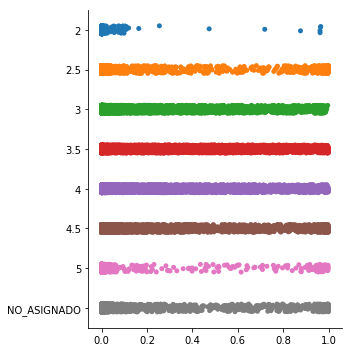

In [308]:
sb.catplot(data=visual_sample,kind="strip", orient="h"
          )

In [309]:
# Categorical distribution plots:

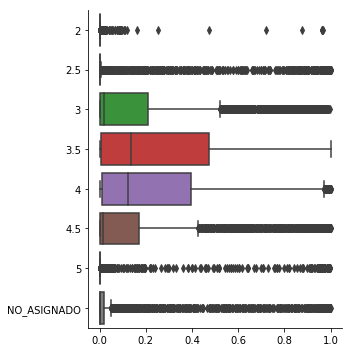

In [310]:
sb.catplot(data=visual_sample,kind="box", orient="h"
          )

In [311]:
visual_sample["2.5"][77]

0.06154612970973292

In [312]:
visual_sample[77:78]

,2,2.5,3,3.5,4,4.5,5,NO_ASIGNADO
77,0.000031,0.061546,0.050031,0.709622,0.000557,0.173393,0.004646,0.000173


In [313]:
visual_sample["2.5"][:]

0       2.504444e-02
1       8.387368e-02
2       2.797068e-04
3       1.640547e-02
4       1.287228e-08
5       3.312265e-05
6       2.482804e-03
7       1.736429e-04
8       2.808752e-02
9       2.519679e-07
10      5.022080e-07
11      3.220137e-04
12      9.362983e-03
13      2.647712e-01
14      5.875801e-05
15      1.194640e-03
16      2.879750e-07
17      3.099597e-04
18      1.235738e-06
19      5.940658e-05
20      2.063371e-05
21      1.364752e-04
22      1.656410e-01
23      9.478438e-04
24      5.032243e-04
25      1.790588e-03
26      1.351580e-07
27      3.178125e-01
28      3.619583e-03
29      3.646276e-06
30      5.275582e-05
31      7.816221e-07
32      2.557650e-05
33      1.219943e-03
34      2.042569e-04
35      4.307481e-06
36      1.865752e-05
37      1.297495e-04
38      6.674487e-03
39      3.877482e-04
40      5.996449e-07
41      1.181922e-03
42      1.146751e-05
43      4.667881e-03
44      6.180080e-01
45      1.152239e-03
46      5.823154e-09
47      1.347

/home/dsc/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


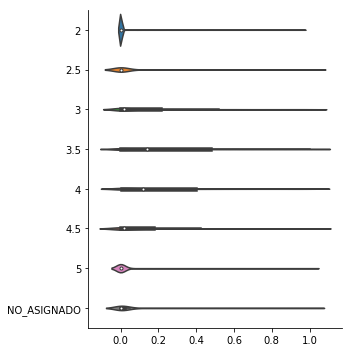

In [314]:
sb.catplot(data=visual_sample,kind="violin", orient="h"
          )

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

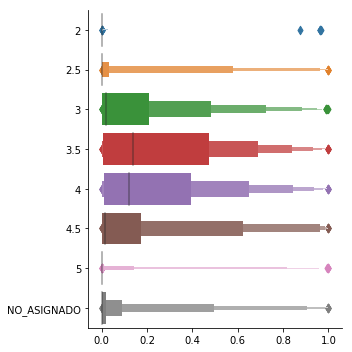

In [315]:
sb.catplot(data=visual_sample,kind="boxen", orient="h"
          )

In [316]:
# Categorical estimate plots:

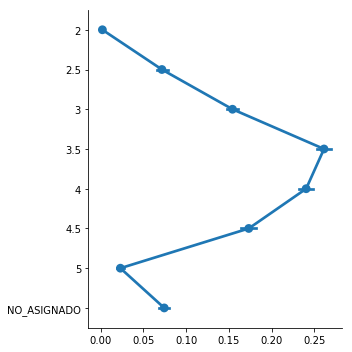

In [317]:
sb.catplot(data=visual_sample,kind="point", orient="h"
          )

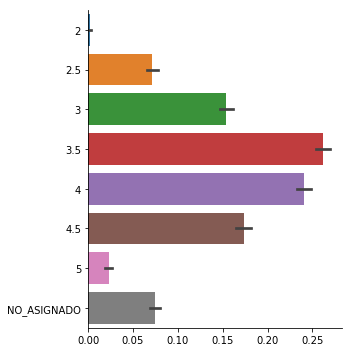

In [318]:
sb.catplot(data=visual_sample,kind="bar", orient="h"
          )

In [319]:
X_test.shape

(61237, 3802)

In [320]:
visual_sample.columns

Index(['2', '2.5', '3', '3.5', '4', '4.5', '5', 'NO_ASIGNADO'], dtype='object')

In [323]:
###################################

In [322]:
!date

mar ene  7 10:49:47 CET 2020


# Partial Dependence Plot

In [192]:
from pdpbox import pdp

ModuleNotFoundError: No module named 'pdpbox'

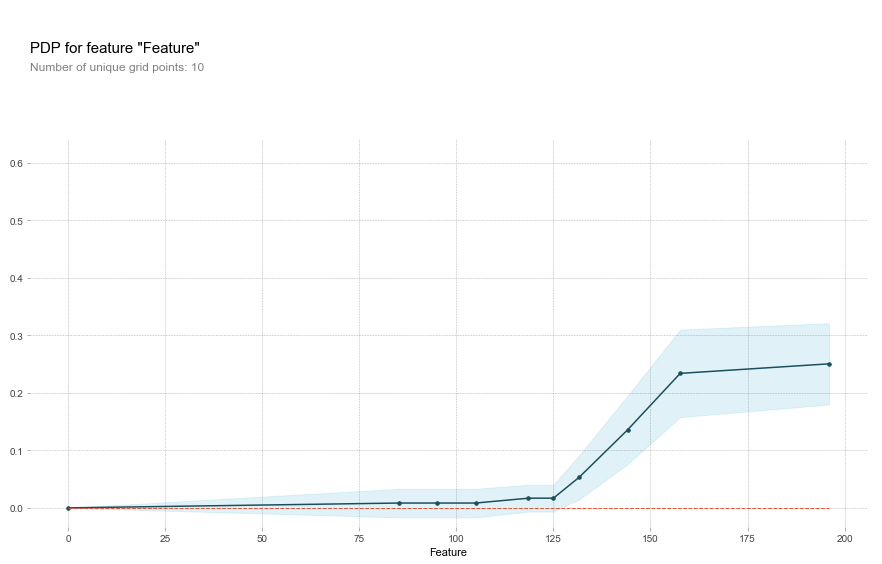

In [60]:
pdp_goals = pdp.pdp_isolate(model=clf, dataset=X_test, model_features=X.columns, feature='Glucose')
pdp.pdp_plot(pdp_goals, 'Feature')
plt.show()